# Download the model

In [1]:
# Example inspired from https://huggingface.co/microsoft/Phi-3-vision-128k-instruct

# Import necessary libraries
from PIL import Image
import requests
from transformers import AutoModelForCausalLM
from transformers import AutoProcessor
from transformers import BitsAndBytesConfig
import torch
from IPython.display import display
import time


# Define model ID
model_id = "microsoft/Phi-3-vision-128k-instruct"

# Load processor
processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)

# Define BitsAndBytes configuration for 4-bit quantization
nf4_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_quant_type="nf4",
    bnb_4bit_use_double_quant=True,
    bnb_4bit_compute_dtype=torch.bfloat16,
)

# Load model with 4-bit quantization and map to CUDA
model = AutoModelForCausalLM.from_pretrained(
    model_id,
    device_map="cuda",
    trust_remote_code=True,
    torch_dtype="auto",
    quantization_config=nf4_config,
)

/home/randellini/anaconda3/envs/llm_images/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/home/randellini/anaconda3/envs/llm_images/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

/home/randellini/anaconda3/envs/llm_images/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [2]:
def model_inference(messages, path_image):
    
    start_time = time.time()
    
    image = Image.open(path_image)

    # Prepare prompt with image token
    prompt = processor.tokenizer.apply_chat_template(
        messages, tokenize=False, add_generation_prompt=True
    )

    # Process prompt and image for model input
    inputs = processor(prompt, [image], return_tensors="pt").to("cuda:0")

    # Generate text response using model
    generate_ids = model.generate(
        **inputs,
        eos_token_id=processor.tokenizer.eos_token_id,
        max_new_tokens=500,
        do_sample=False,
    )

    # Remove input tokens from generated response
    generate_ids = generate_ids[:, inputs["input_ids"].shape[1] :]

    # Decode generated IDs to text
    response = processor.batch_decode(
        generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False
    )[0]


    display(image)
    end_time = time.time()
    print("Inference time: {}".format(end_time - start_time))

    # Print the generated response
    print(response)

# Identity card - OCR

## Front - cie standard and test

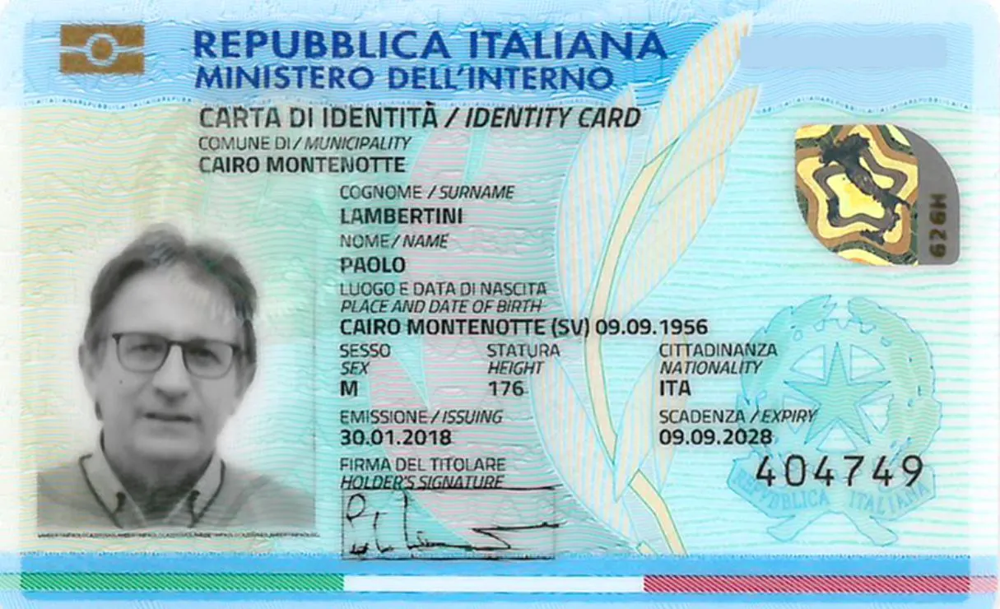

Inference time: 10.802738189697266
{
  "COMUNE DI/ MUNICIPALITY": "CAIRO MONTENOTTE",
  "COGNOME /Surname": "LAMBERTINI",
  "NOME/NAME": "PAOLO",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "CAIRO MONTENOTTE (SV) 09.09.1956",
  "SESSO/SEX": "M",
  "STATURA/HEIGHT": "176",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.01.2018",
  "SCADENZA /EXPIRY": "09.09.2028",
  "CODE": "404749"
}


In [4]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cie_fronte_standard.jpg"

# inference
model_inference(prompt_cie_front, path_image)

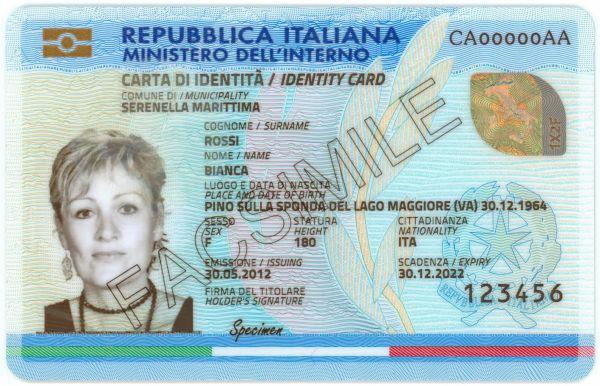

Inference time: 10.919249534606934
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONDA DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.05.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CA00000AA"
}


In [6]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cie_fronte_test.jpg"

# inference
model_inference(prompt_cie_front, path_image)

## Front - cie test transformed

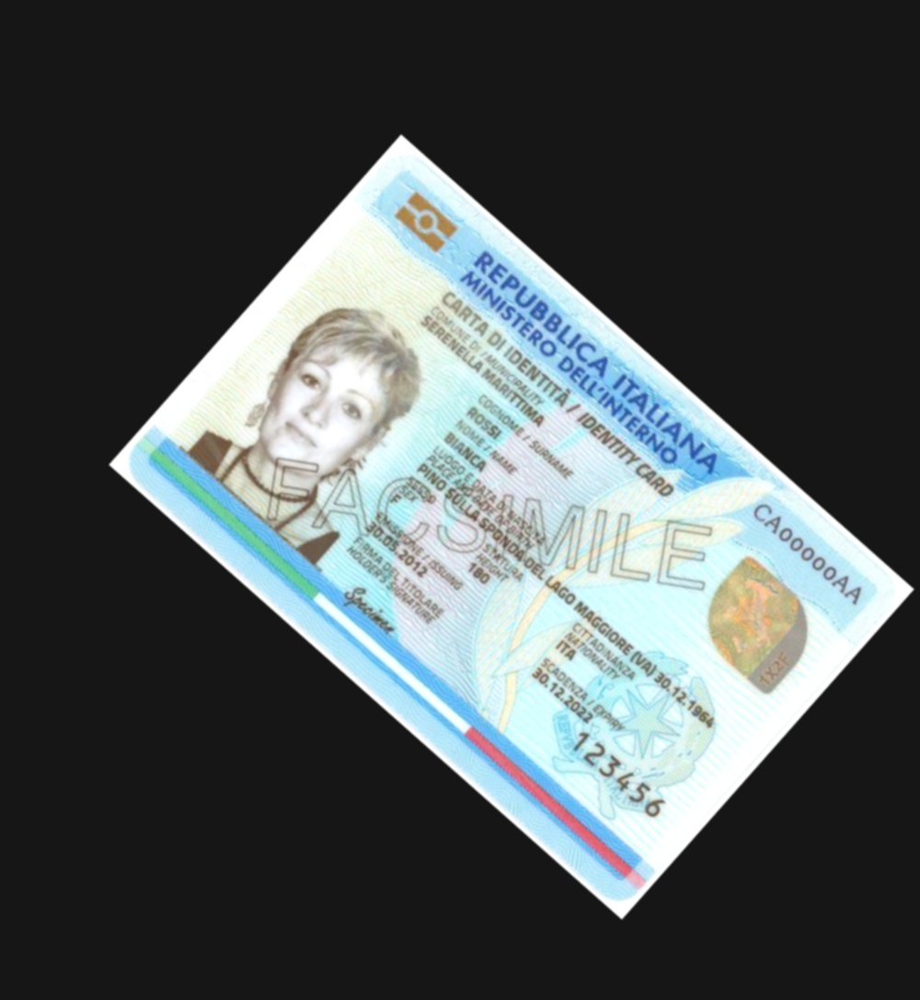

Inference time: 9.538761615753174
{
"COMUNE DI/ MUNICIPALITY": "REPUBBLICA ITALIANA",
"COGNOME /SURNAME": "CAOOOAA",
"NOME/NAME": "MILLE",
"LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "LACO MAGGIORE (VIA) 30 12.1985",
"SESSO/SEX": "F",
"STATURA/HEIGHT": "123456",
"CITADINANZA/NATIONALITY": "ITA",
"EMISSIONE/ ISSUING": "2012",
"SCADENZA /EXPIRY": "30 12 2021"
}


In [7]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod1.jpg"

# inference
model_inference(prompt_cie_front, path_image)

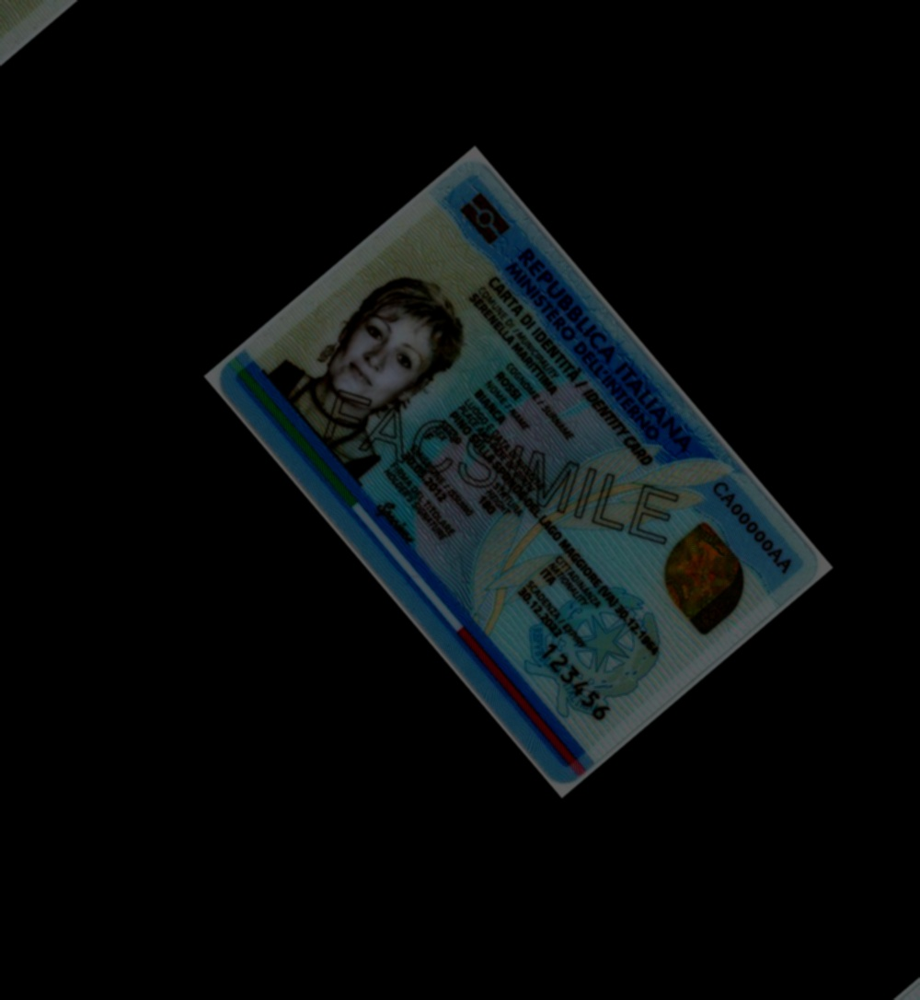

Inference time: 9.258262872695923
{
  "COMUNE DI/ MUNICIPALITY": "MILAN",
  "COGNOME /SURNAME": "CARTA DI DIGENITA",
  "NOME/NAME": "GIULIA",
  "LUOGO E DATA DI NASCITA": "12/34/56",
  "SESSO/SEX": "F",
  "STATURA /HEIGHT": "1.55",
  "CITADINANZA /NATIONALITY": "ITALIA",
  "EMISSIONE": "10000AA",
  "SCADENZA": "12/34/56",
  "CODE": "10000AA"
}


In [8]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod2.jpg"

# inference
model_inference(prompt_cie_front, path_image)

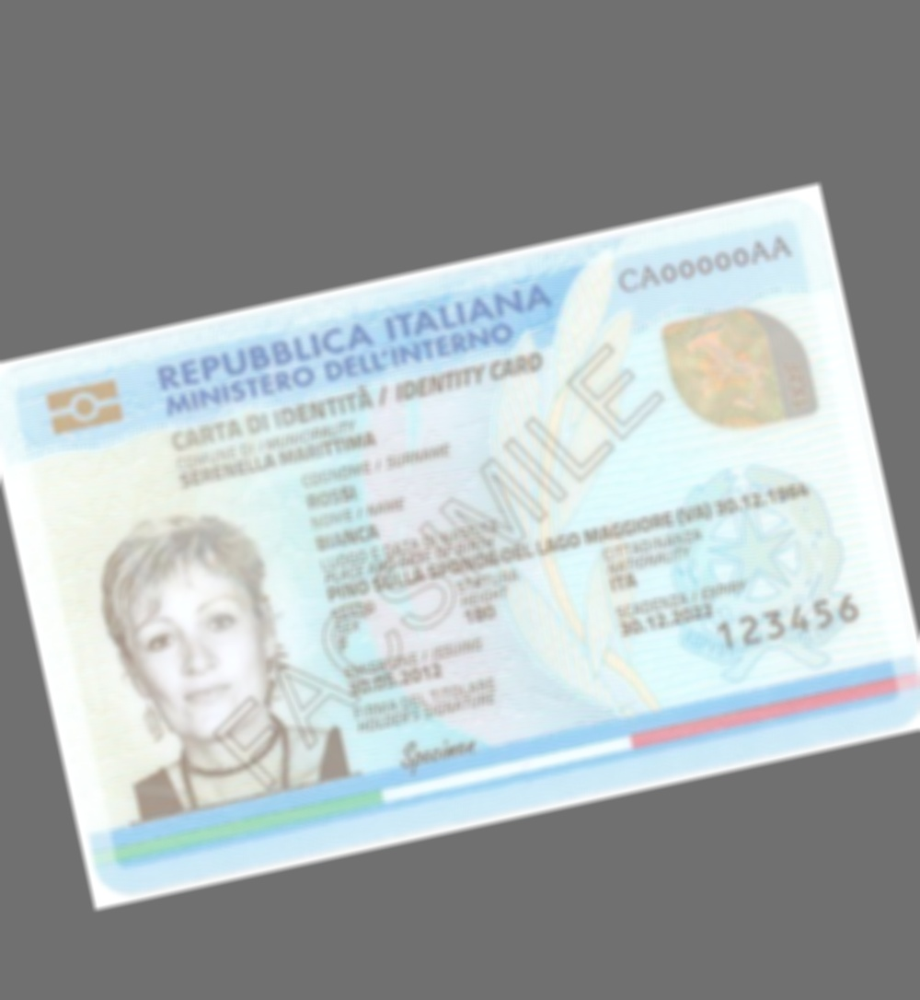

Inference time: 9.557661771774292
{
  "COMUNE DI/ MUNICIPALITY": "REPUBBLICA ITALIANA",
  "COGNOME /SURNAME": "MINISTERO DELL'INTERNO",
  "NOME/NAME": "MILCE",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "BENGIVERNA, ITALY 1954",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "165 cm",
  "CITADINANZA/NATIONALITY": "ITALIANO",
  "EMISSIONE/ ISSUING": "2013",
  "SCADENZA /EXPIRY": "2018"
}


In [9]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod4.jpg"

# inference
model_inference(prompt_cie_front, path_image)

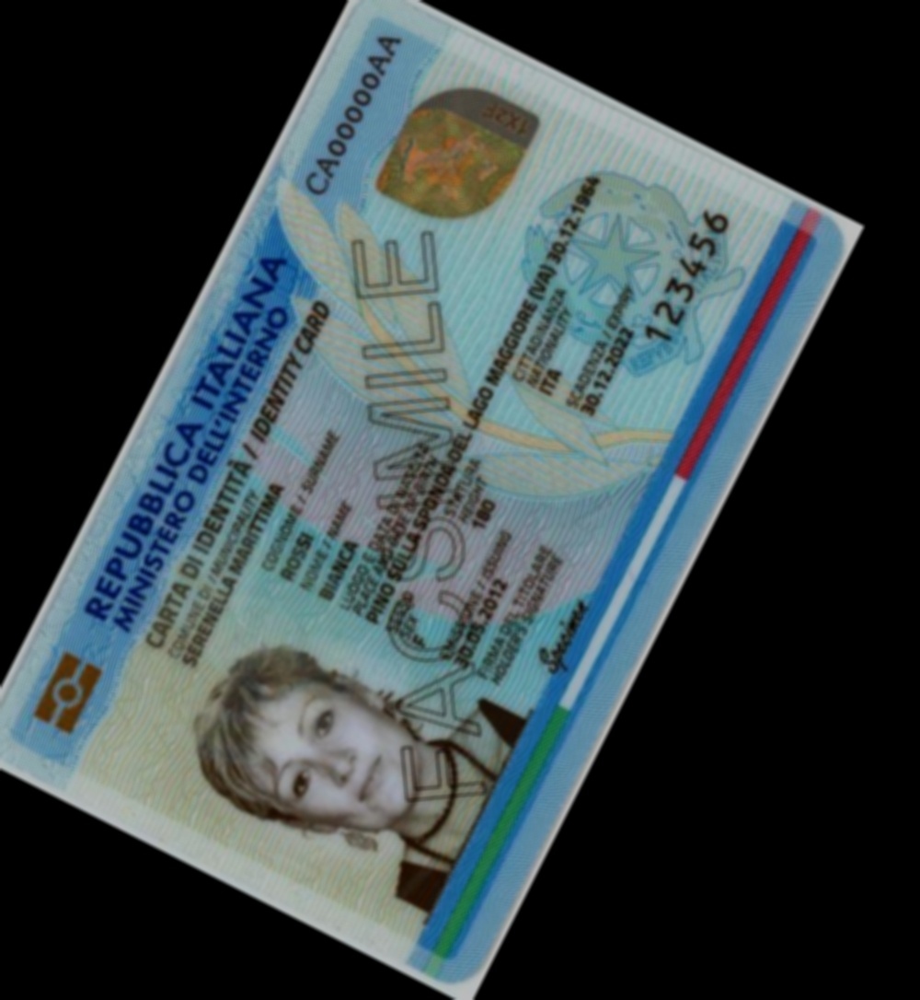

Inference time: 8.543677806854248
{
  "COMUNE DI/ MUNICIPALITY": "Repubblica italiana",
  "COGNOME /SURNAME": "Meggiorino",
  "NOME/NAME": "Luigi",
  "LUOGO E DATA DI NASCITA": "Roma, 12/11/1994",
  "SESSO": "M",
  "STATURA": "1.73 m",
  "CITADINANZA": "Italiana",
  "EMISSIONE": "12/11/2011",
  "SCADENZA": "12/11/2011",
  "CODE": "12354"
}


In [10]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod5.jpg"

# inference
model_inference(prompt_cie_front, path_image)

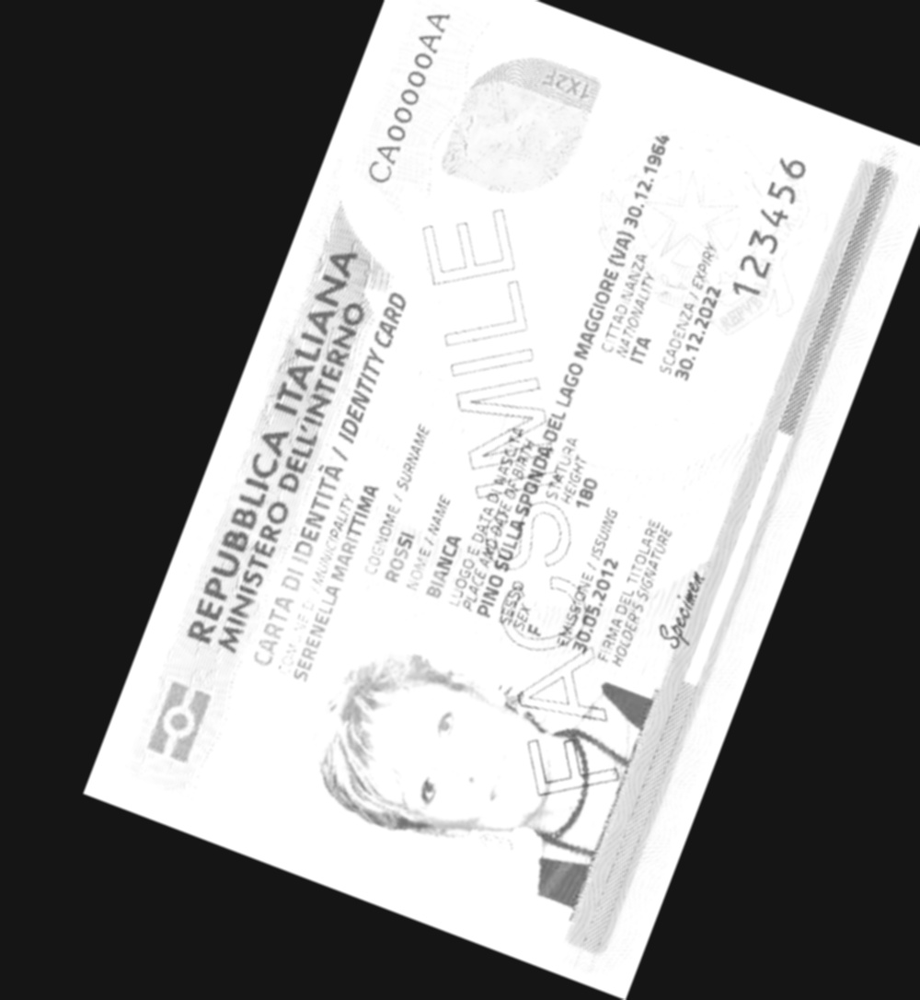

Inference time: 8.736359596252441
{
"COMUNE DI/ MUNICIPALITY": "REPUBBLICA ITALIANA",
"COGNOME /SURNAME": "ROSSI",
"NOME/NAME": "ROSSI",
"LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SORRA",
"SESSO/SEX": "F",
"STATURA/HEIGHT": "180",
"CITADINANZA/NATIONALITY": "ITA",
"EMISSIONE/ ISSUING": "30.12.2024",
"SCADENZA /EXPIRY": "123456"
}


In [11]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod6.jpg"

# inference
model_inference(prompt_cie_front, path_image)

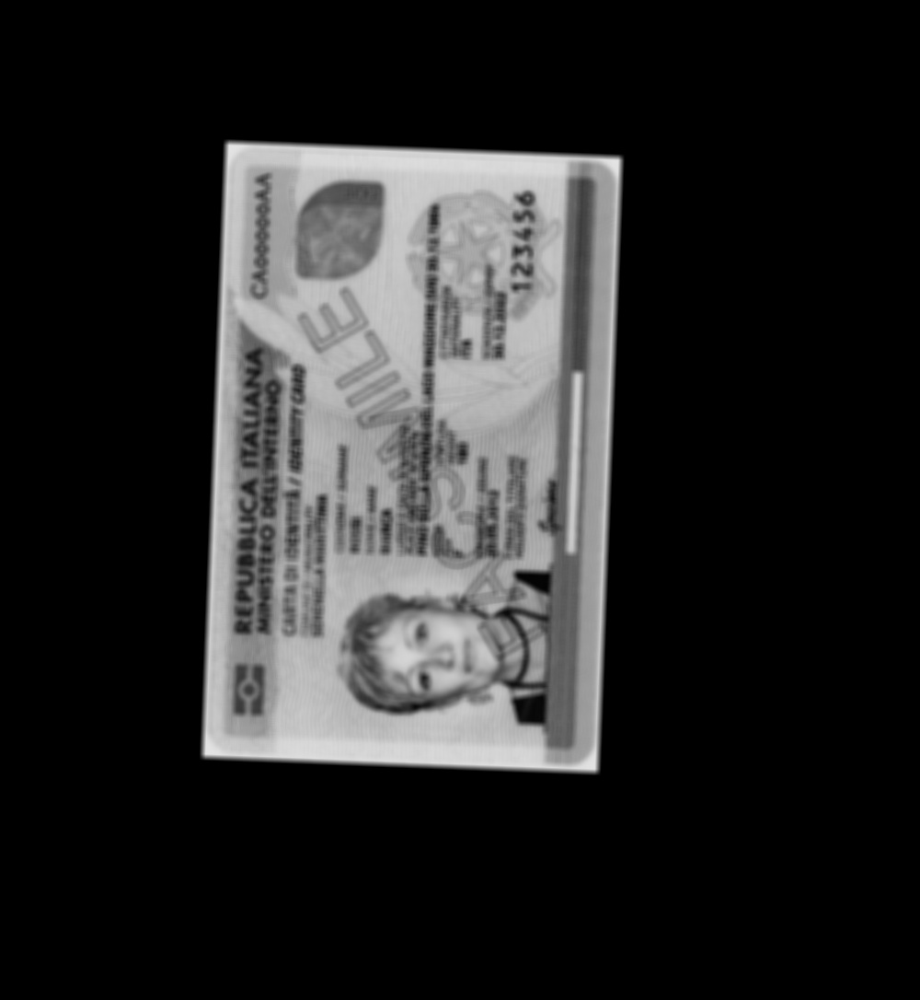

Inference time: 8.761054992675781
{
  "COMUNE DI/ MUNICIPALITY": "REPUBBLICA ITALIANA",
  "COGNOME /SURNAME": "CAMERA",
  "NOME/NAME": "GIULIANO",
  "LUOGO E DATA DI NASCITA": "123456",
  "SESSO/SEX": "M",
  "STATURA /HEIGHT": "170",
  "CITADINANZA /NATIONALITY": "ITALIANA",
  "EMISSIONE": "1998",
  "SCADENZA": "2000",
  "CODE": "123456"
}


In [12]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod7.jpg"

# inference
model_inference(prompt_cie_front, path_image)

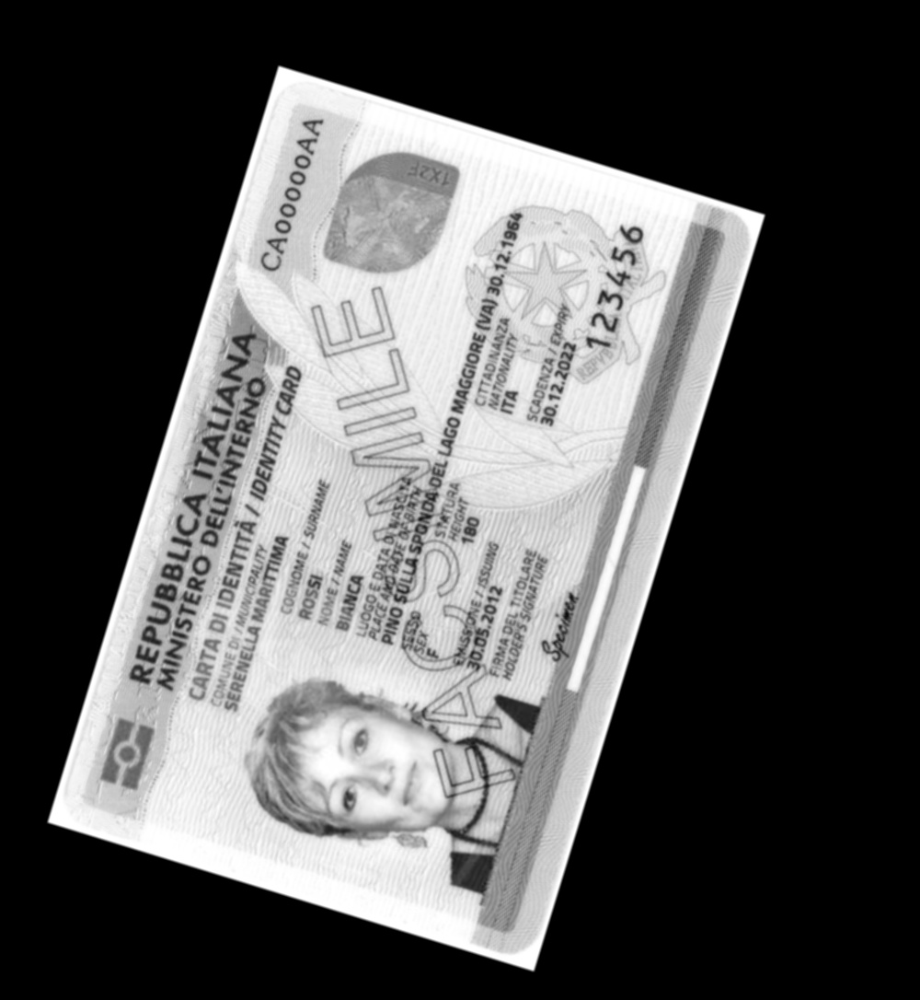

Inference time: 9.858752489089966
{
  "COMUNE DI/ MUNICIPALITY": "SERELLA MARITIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "MICHAEL",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "ROSSE / ROSSI 1964",
  "SESSO/SEX": "M",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "12/3/2012",
  "SCADENZA /EXPIRY": "30/12/2022",
  "CODE": "123456"
}


In [13]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod8.jpg"

# inference
model_inference(prompt_cie_front, path_image)

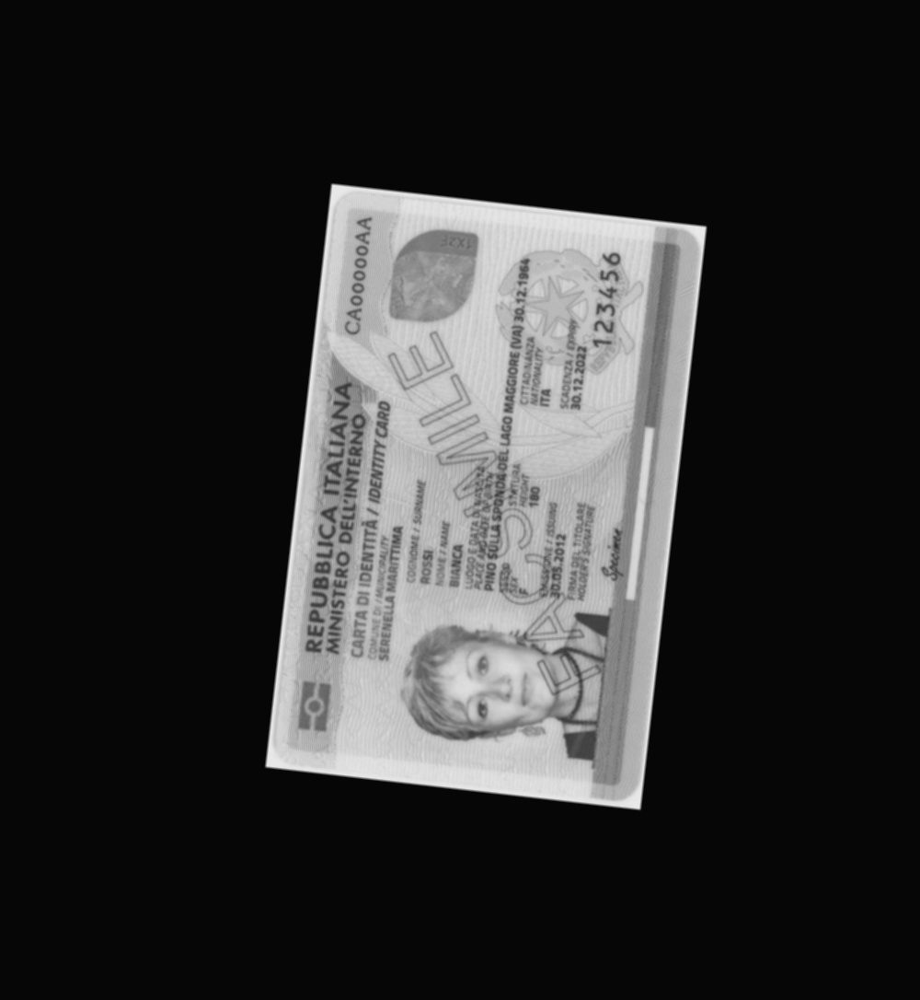

Inference time: 9.606581211090088
{
"COMUNE DI/ MUNICIPALITY": "ITALIANA MINISTERO DEL DELFINI",
"COGNOME /SURNAME": "ROSSI",
"NOME/NAME": "SEMINIA MARGARI",
"LUOGO E DATA DI NASCITA": "ROSARI, ROMA, ITALIA 012-12-1944",
"SESSO/SEX": "F",
"STATURA/HEIGHT": "1.73",
"CITADINANZA/NATIONALITY": "ITALIANA",
"EMISSIONE": "123456",
"SCADENZA": "123456",
"CODE": "123456"
}


In [14]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/transformed/cie_fronte_mod9.jpg"

# inference
model_inference(prompt_cie_front, path_image)

## Front - cie test cleaned

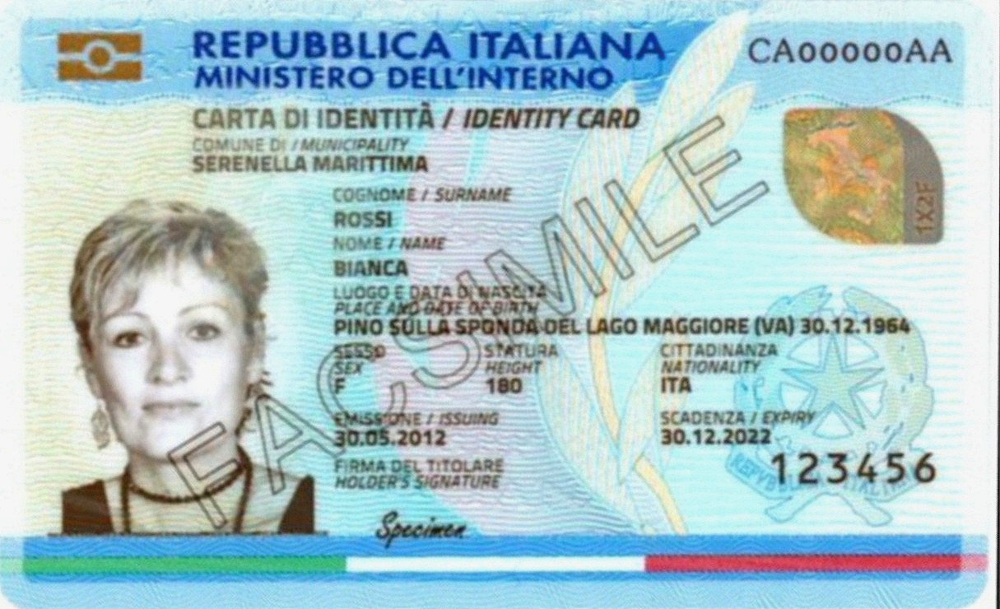

Inference time: 11.20967149734497
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONDA-DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.05.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CA00000AA"
}


In [24]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod1.jpg"

# inference
model_inference(prompt_cie_front, path_image)

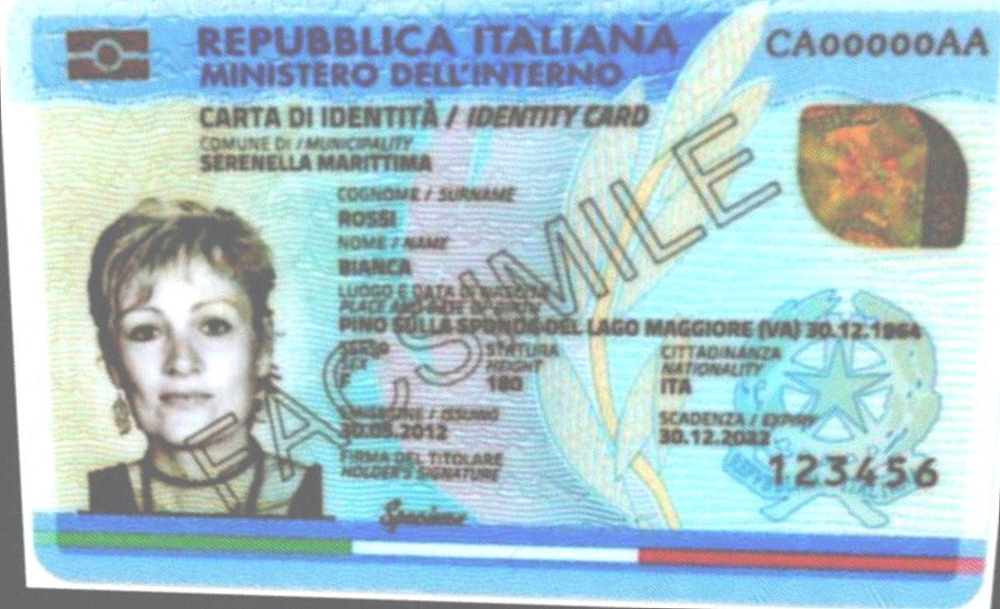

Inference time: 11.127386331558228
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "Bianca",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO GULLA SPIROSO DEL LAGO MAGGIORES (VA) 30.12.1964",
  "SESSO/SEX": "FEMALE",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.12.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "123456"
}


In [25]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod2.jpg"

# inference
model_inference(prompt_cie_front, path_image)

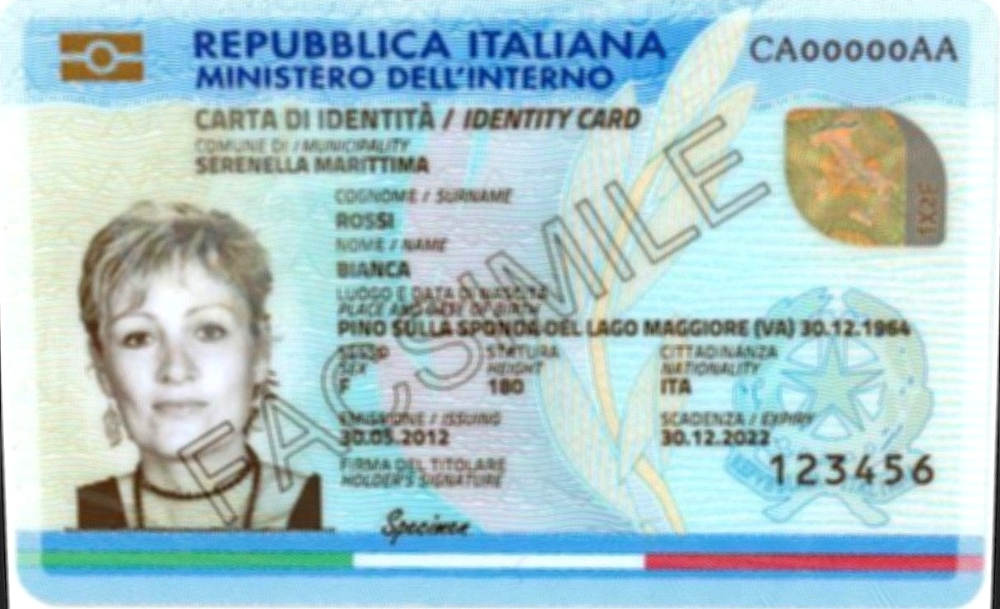

Inference time: 10.91502070426941
{
  "COMUNE DI/ MUNICIPALITY": "SERNELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONSO DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.12.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CAOOOOAA"
}


In [26]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod3.jpg"

# inference
model_inference(prompt_cie_front, path_image)

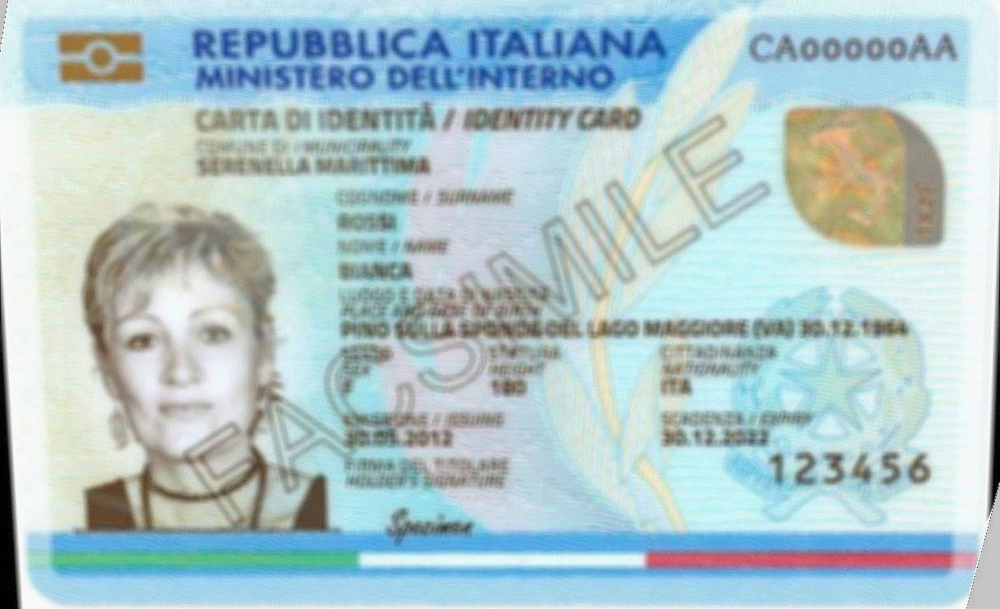

Inference time: 9.088798999786377
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "ROSSI",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "ROSSI",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "1.65",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "2013",
  "SCADENZA /EXPIRY": "2018",
  "CODE": "CAOOOOAA"
}


In [27]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod4.jpg"

# inference
model_inference(prompt_cie_front, path_image)

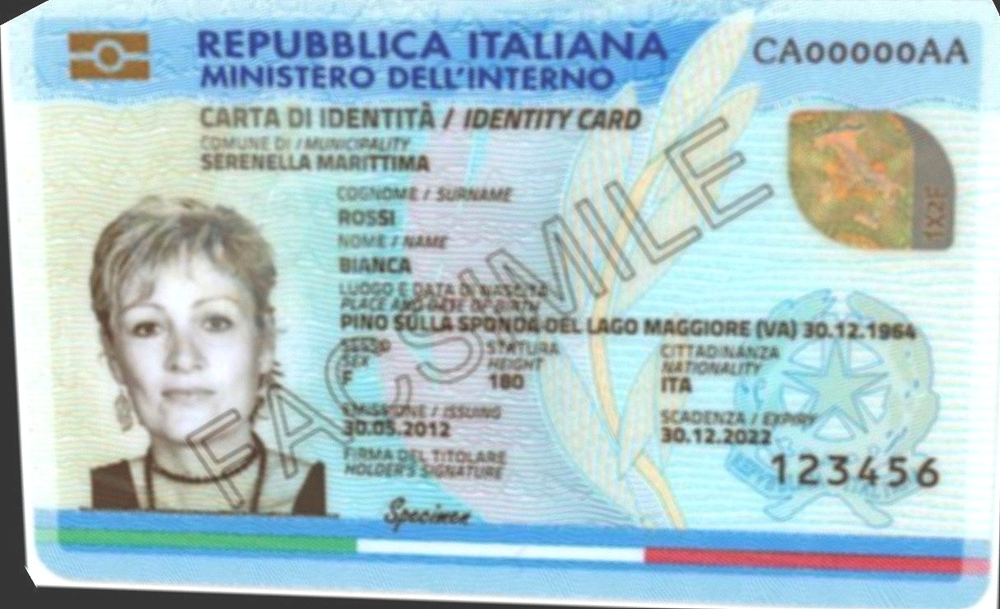

Inference time: 11.25399661064148
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONSO-DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.12.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CA0000AA"
}


In [28]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod5.jpg"

# inference
model_inference(prompt_cie_front, path_image)

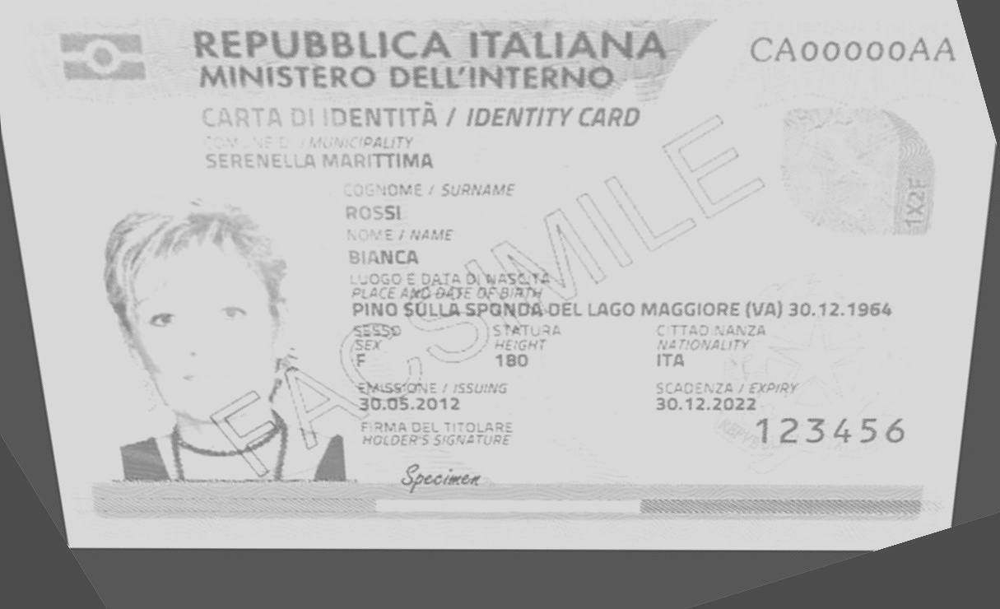

Inference time: 11.518493413925171
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONDA DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.05.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "123456"
}


In [29]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod6.jpg"

# inference
model_inference(prompt_cie_front, path_image)

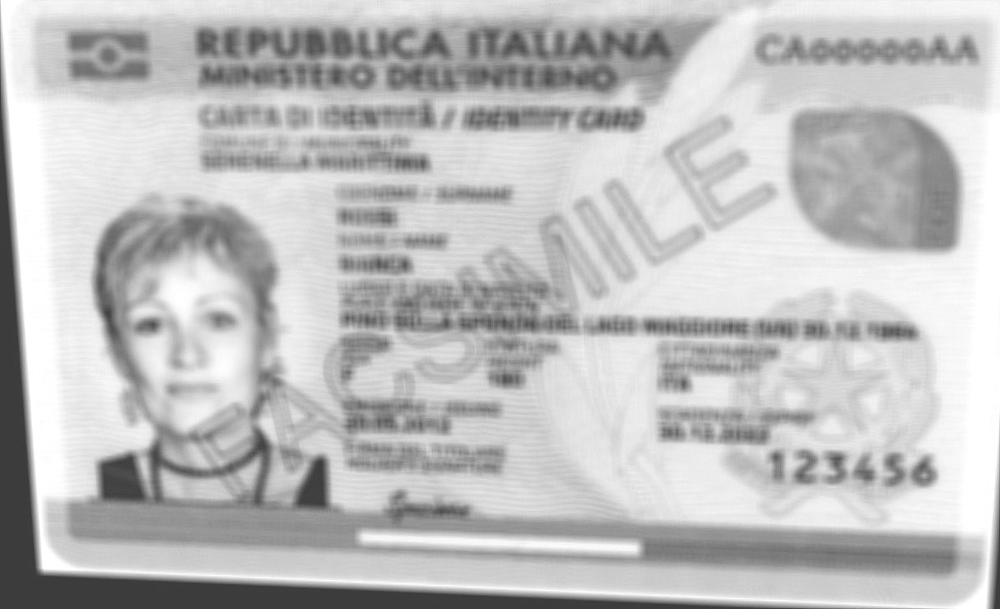

Inference time: 8.853993654251099
{
  "COMUNE DI/ MUNICIPALITY": "REPUBBLICA ITALIANA",
  "COGNOME /SURNAME": "CADOOOAA",
  "NOME/NAME": "SMILE",
  "LUOGO E DATA DI NASCITA": "CALZATO, ITALY 123456",
  "SESSO": "FEMALE",
  "STATURA": "1.65",
  "CITADINANZA": "ITALIAN",
  "EMISSIONE": "1990",
  "SCADENZA": "1990",
  "CODE": "123456"
}


In [30]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod7.jpg"

# inference
model_inference(prompt_cie_front, path_image)

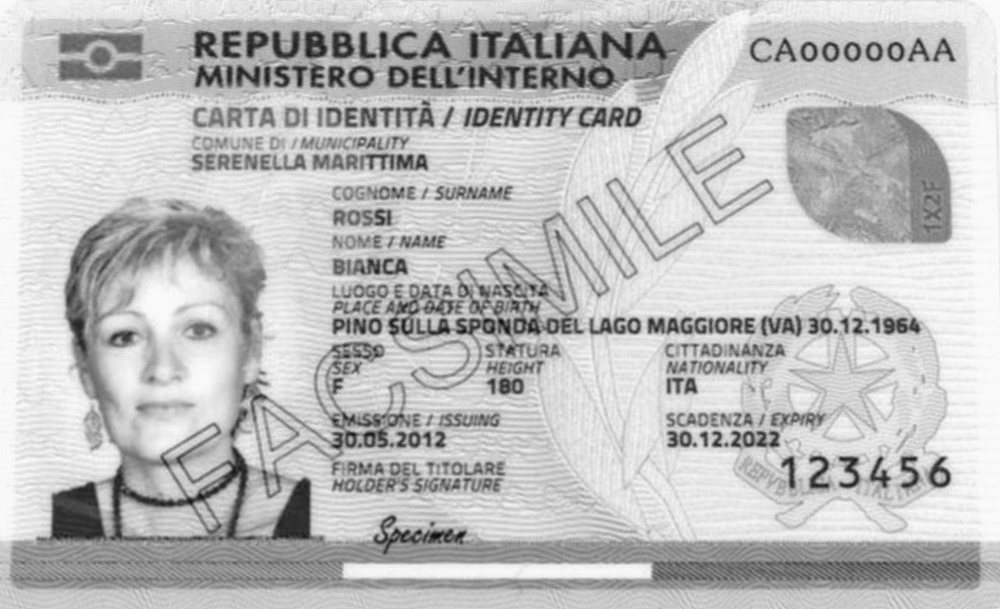

Inference time: 11.038347721099854
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONDA-DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.05.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CAOOOOAA"
}


In [31]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod8.jpg"

# inference
model_inference(prompt_cie_front, path_image)

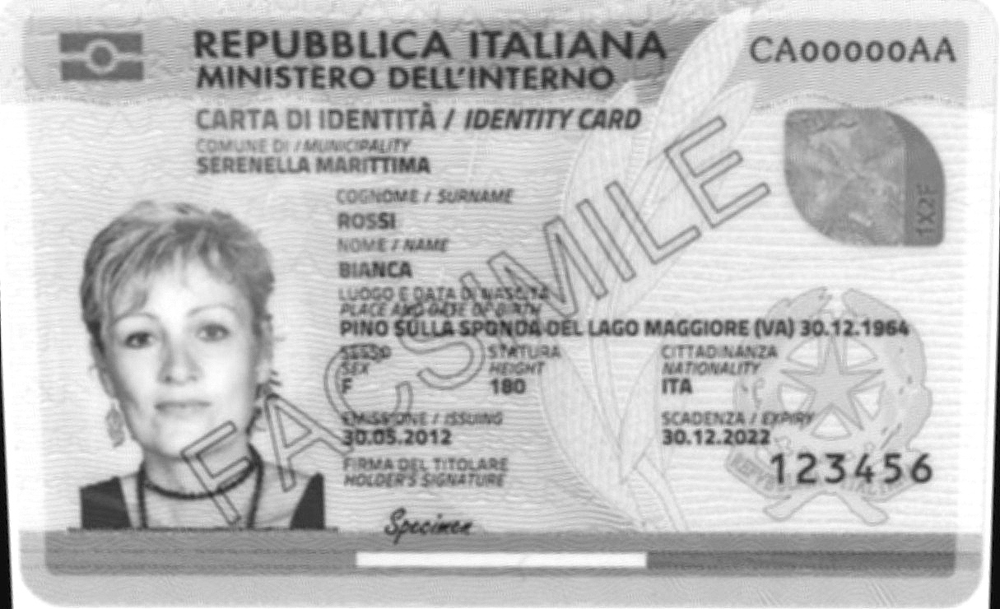

Inference time: 10.94846224784851
{
  "COMUNE DI/ MUNICIPALITY": "SERENELLA MARITTIMA",
  "COGNOME /SURNAME": "ROSSI",
  "NOME/NAME": "BIANCA",
  "LUOGO E DATA DI NASCITA/PLACE AND DATE OF BIRTH": "PINO SULLA SPONDA DEL LAGO MAGGIORE (VA) 30.12.1964",
  "SESSO/SEX": "F",
  "STATURA/HEIGHT": "180",
  "CITADINANZA/NATIONALITY": "ITA",
  "EMISSIONE/ ISSUING": "30.05.2012",
  "SCADENZA /EXPIRY": "30.12.2022",
  "CODE": "CA0000AA"
}


In [32]:
prompt_cie_front = [{"role": "user", "content": "<|image_1|>\nOCR the text of the image. Extract the text of the following fields and put it in a JSON format: \
'COMUNE DI/ MUNICIPALITY', 'COGNOME /SURNAME', 'NOME/NAME', 'LUOGO E DATA DI NASCITA/\
PLACE AND DATE OF BIRTH', 'SESSO/SEX', 'STATURA/HEIGHT', 'CITADINANZA/NATIONALITY',\
'EMISSIONE/ ISSUING', 'SCADENZA /EXPIRY'. Read the code at the top right and put in in the JSON field 'CODE'"}]

# Download image from URL
path_image = "/home/randellini/llm_images/resources/cleaned_images/cie_fronte_mod9.jpg"

# inference
model_inference(prompt_cie_front, path_image)